In [1]:
import pandas as pd
from rdkit import Chem
import seaborn as sns
from tqdm import tqdm
import numpy as np
import matplotlib.pyplot as plt

In [2]:
tqdm.pandas()


In [3]:
import mols2grid

In [4]:
from rdkit import Chem
from rdkit.Chem import rdChemReactions
from rdkit.Chem import Draw

In [5]:
def count_amides(smiles: str):
    sma = Chem.MolFromSmarts("[NX3][CX3](=[OX1])") # from daylight manual with [#6] removed, allow sulfamides etc
    mol = Chem.MolFromSmiles(smiles)
    matches = mol.GetSubstructMatches(sma)
    return len(matches)

In [6]:
from rdkit import Chem
from rdkit.Chem import rdChemReactions
import pandas as pd


def split_amide(smiles: str):

    mol = Chem.MolFromSmiles(smiles)
    reaction_smarts = "[C:1](=[O:2])[N:3]>>[C:1](=[O:2])[OX2H1].[N:3]"
    reaction = rdChemReactions.ReactionFromSmarts(reaction_smarts)
    products = reaction.RunReactants((mol,))
    
    for product_set in products:
        frags = []

        for fragment in product_set:
            frags.append(fragment)
    
    if len(frags) == 2:
        # only want actual disconnections
        print(f"frag1: {Chem.MolToSmiles(frags[0])}")
        print(f"frag2: {Chem.MolToSmiles(frags[1])}")
        return frags
        
    else:
        return pd.NA
        
        

In [7]:

def split_amide_to_smiles(smiles: str):
    mol = Chem.MolFromSmiles(smiles)
    reaction_smarts = "[C:1](=[O:2])[N:3]>>[C:1](=[O:2])[OX2H1].[N:3]"
    reaction = rdChemReactions.ReactionFromSmarts(reaction_smarts)
    products = reaction.RunReactants((mol,))

    if len(products) == 0:
        return pd.NA
        
    for product_set in products:
        frags = []
        for fragment in product_set:
            frags.append(fragment)
    
    
    if len(frags) == 2:
        # only want actual disconnections
        # print(f"frag1: {Chem.MolToSmiles(frags[0])}")
        # print(f"frag2: {Chem.MolToSmiles(frags[1])}")
        return Chem.MolToSmiles(frags[0]),  Chem.MolToSmiles(frags[1])
        
    else:
        return pd.NA


In [8]:
all_actives = pd.read_csv("./final/actives_final.csv")

In [9]:
from rdkit.Chem import rdMolDescriptors


In [10]:
def smi_to_MW(smiles):
    try:
        mol = Chem.MolFromSmiles(smiles)
        return rdMolDescriptors.CalcExactMolWt(mol)
    except:
        return pd.NA

In [11]:
all_actives["MW"] = all_actives["CANONICAL_SMILES"].apply(lambda x: smi_to_MW(x))

In [12]:
all_actives

,CANONICAL_SMILES,INCHIKEY,action_type,active,common_name,appears_in_N_datasets,dataset_CHEMBL1142817,dataset_XinXu_NCATS_ADME_raw,dataset_aid_589039_clinically_relevant,dataset_carbon-mangels_2011,dataset_drugbank,dataset_flockheart,assay_count,pChEMBL mean,inclusion_score,MW
0,CC/C(=C(\c1ccccc1)c1ccc(OCCN(C)C)cc1)c1ccccc1,NKANXQFJJICGDU-QPLCGJKRSA-N,substrate,True,Tamoxifen,4,True,True,False,False,True,True,14.0,4.846154,18.0,371.224915
1,Clc1ccccc1C(c1ccccc1)(c1ccccc1)n1ccnc1,VNFPBHJOKIVQEB-UHFFFAOYSA-N,substrate,True,Clotrimazole,2,False,False,False,True,True,False,14.0,7.237692,16.0,344.108026
2,CNCCCC12CCC(c3ccccc31)c1ccccc12,QSLMDECMDJKHMQ-UHFFFAOYSA-N,substrate,True,maprotiline,2,False,True,False,True,False,False,13.0,5.473846,15.0,277.183050
3,CN(C)CCCN1c2ccccc2CCc2ccc(Cl)cc21,GDLIGKIOYRNHDA-UHFFFAOYSA-N,substrate,True,Clomipramine,3,False,True,False,True,True,False,11.0,4.645455,14.0,314.154976
4,COC(=O)C1=C(C)N=C(C)C(C(=O)OC)C1c1ccccc1[N+](=...,OSUCQKNXQBPLDG-UHFFFAOYSA-N,substrate,True,Nifedipine,4,False,False,True,True,True,True,10.0,4.888000,14.0,346.116486
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5085,CCN(CC)CCSC(=O)C(c1ccccc1)c1ccccc1,WHLUQAYNVOGZST-UHFFFAOYSA-N,substrate,True,NaN,1,False,True,False,False,False,False,NaN,NaN,NaN,327.165685
5086,COc1ccc(/C=C/C(=O)O)cc1,AFDXODALSZRGIH-QPJJXVBHSA-N,substrate,True,NaN,1,False,True,False,False,False,False,NaN,NaN,NaN,178.062994
5087,CCOC(=O)C1=C(C)N=C(C)C(C(=O)OCC)C1c1ccccc1/C=C...,BGYJFSXPRMOZJK-PFONDFGASA-N,substrate,True,lacidipine,1,False,False,False,True,False,False,NaN,NaN,NaN,455.230788
5088,CCCCNC(=O)NS(=O)(=O)c1ccc(N)cc1,VDTNNGKXZGSZIP-UHFFFAOYSA-N,substrate,True,NaN,1,False,True,False,False,False,False,NaN,NaN,NaN,271.099062


In [13]:
mols2grid.display(all_actives, smiles_col="CANONICAL_SMILES")

MolGridWidget()

<Axes: xlabel='MW', ylabel='Count'>

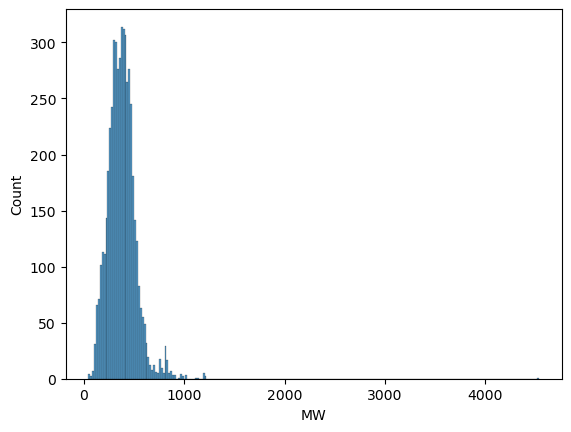

In [14]:
sns.histplot(data =all_actives, x="MW")

In [15]:
all_actives["n_amides"] = all_actives["CANONICAL_SMILES"].progress_apply(lambda x: count_amides(x))


00%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5090/5090 [00:00<00:00, 11493.98it/s]

In [16]:
all_actives["n_amides"].value_counts()

n_amides
0     3012
1     1419
2      472
3      119
4       46
5        9
11       7
6        3
7        2
39       1
Name: count, dtype: int64

In [17]:
all_actives["products"] = all_actives["CANONICAL_SMILES"].progress_apply(lambda x: split_amide_to_smiles(x))


00%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5090/5090 [00:00<00:00, 6563.75it/s]

In [18]:
all_actives["carboxy"] = all_actives["products"].apply(lambda x: x[0] if x is not pd.NA else pd.NA)

In [19]:
all_actives["amine"] = all_actives["products"].apply(lambda x: x[1] if x is not pd.NA else pd.NA)

In [20]:
all_actives

,CANONICAL_SMILES,INCHIKEY,action_type,active,common_name,appears_in_N_datasets,dataset_CHEMBL1142817,dataset_XinXu_NCATS_ADME_raw,dataset_aid_589039_clinically_relevant,dataset_carbon-mangels_2011,dataset_drugbank,dataset_flockheart,assay_count,pChEMBL mean,inclusion_score,MW,n_amides,products,carboxy,amine
0,CC/C(=C(\c1ccccc1)c1ccc(OCCN(C)C)cc1)c1ccccc1,NKANXQFJJICGDU-QPLCGJKRSA-N,substrate,True,Tamoxifen,4,True,True,False,False,True,True,14.0,4.846154,18.0,371.224915,0,<NA>,<NA>,<NA>
1,Clc1ccccc1C(c1ccccc1)(c1ccccc1)n1ccnc1,VNFPBHJOKIVQEB-UHFFFAOYSA-N,substrate,True,Clotrimazole,2,False,False,False,True,True,False,14.0,7.237692,16.0,344.108026,0,<NA>,<NA>,<NA>
2,CNCCCC12CCC(c3ccccc31)c1ccccc12,QSLMDECMDJKHMQ-UHFFFAOYSA-N,substrate,True,maprotiline,2,False,True,False,True,False,False,13.0,5.473846,15.0,277.183050,0,<NA>,<NA>,<NA>
3,CN(C)CCCN1c2ccccc2CCc2ccc(Cl)cc21,GDLIGKIOYRNHDA-UHFFFAOYSA-N,substrate,True,Clomipramine,3,False,True,False,True,True,False,11.0,4.645455,14.0,314.154976,0,<NA>,<NA>,<NA>
4,COC(=O)C1=C(C)N=C(C)C(C(=O)OC)C1c1ccccc1[N+](=...,OSUCQKNXQBPLDG-UHFFFAOYSA-N,substrate,True,Nifedipine,4,False,False,True,True,True,True,10.0,4.888000,14.0,346.116486,0,<NA>,<NA>,<NA>
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5085,CCN(CC)CCSC(=O)C(c1ccccc1)c1ccccc1,WHLUQAYNVOGZST-UHFFFAOYSA-N,substrate,True,NaN,1,False,True,False,False,False,False,NaN,NaN,NaN,327.165685,0,<NA>,<NA>,<NA>
5086,COc1ccc(/C=C/C(=O)O)cc1,AFDXODALSZRGIH-QPJJXVBHSA-N,substrate,True,NaN,1,False,True,False,False,False,False,NaN,NaN,NaN,178.062994,0,<NA>,<NA>,<NA>
5087,CCOC(=O)C1=C(C)N=C(C)C(C(=O)OCC)C1c1ccccc1/C=C...,BGYJFSXPRMOZJK-PFONDFGASA-N,substrate,True,lacidipine,1,False,False,False,True,False,False,NaN,NaN,NaN,455.230788,0,<NA>,<NA>,<NA>
5088,CCCCNC(=O)NS(=O)(=O)c1ccc(N)cc1,VDTNNGKXZGSZIP-UHFFFAOYSA-N,substrate,True,NaN,1,False,True,False,False,False,False,NaN,NaN,NaN,271.099062,2,"(CCCCNC(=O)O, Nc1ccc(S(N)(=O)=O)cc1)",CCCCNC(=O)O,Nc1ccc(S(N)(=O)=O)cc1


In [21]:
has_disconnection = all_actives[all_actives["products"].notna()]
has_disconnection

,CANONICAL_SMILES,INCHIKEY,action_type,active,common_name,appears_in_N_datasets,dataset_CHEMBL1142817,dataset_XinXu_NCATS_ADME_raw,dataset_aid_589039_clinically_relevant,dataset_carbon-mangels_2011,dataset_drugbank,dataset_flockheart,assay_count,pChEMBL mean,inclusion_score,MW,n_amides,products,carboxy,amine
16,O=C1CC2(CCCC2)CC(=O)N1CCCCN1CCN(c2ncccn2)CC1,QWCRAEMEVRGPNT-UHFFFAOYSA-N,substrate,True,buspirone,5,False,True,True,True,True,True,6.0,4.850,11.0,385.247775,2,"(O=CCC1(CC(=O)O)CCCC1, CC1(CC(=O)NCCCCN2CCN(c3...",O=CCC1(CC(=O)O)CCCC1,CC1(CC(=O)NCCCCN2CCN(c3ncccn3)CC2)CCCC1
19,O=C1CCc2cc(OCCCCc3nnnn3C3CCCCC3)ccc2N1,RRGUKTPIGVIEKM-UHFFFAOYSA-N,substrate,True,cilostazol,5,False,True,True,True,True,True,5.0,4.940,10.0,369.216475,1,"(O=C(O)CCc1cccc(OCCCCc2nnnn2C2CCCCC2)c1, CCc1c...",O=C(O)CCc1cccc(OCCCCc2nnnn2C2CCCCC2)c1,CCc1cc(OCCCCc2nnnn2C2CCCCC2)ccc1N
20,COc1ccc(Cl)cc1C(=O)NCCc1ccc(S(=O)(=O)NC(=O)NC2...,ZNNLBTZKUZBEKO-UHFFFAOYSA-N,substrate,True,glyburide,2,False,False,False,True,True,False,8.0,5.250,10.0,493.143820,3,(COc1ccc(Cl)cc1C(=O)NCCc1ccc(S(=O)(=O)NC(=O)O)...,COc1ccc(Cl)cc1C(=O)NCCc1ccc(S(=O)(=O)NC(=O)O)cc1,NC1CCCCC1
22,CC(C)c1nc(CN(C)C(=O)NC(C(=O)N[C@@H](Cc2ccccc2)...,NCDNCNXCDXHOMX-BWGGSIGWSA-N,substrate,True,ritonavir,6,True,True,True,True,True,True,4.0,7.395,10.0,720.312761,4,"(O=C(O)OCc1cncs1, CC(C)c1nc(CN(C)C(=O)NC(C(=O)...",O=C(O)OCc1cncs1,CC(C)c1nc(CN(C)C(=O)NC(C(=O)N[C@@H](Cc2ccccc2)...
27,COc1ccc([C@@H]2Sc3ccccc3N(CCN(C)C)C(=O)C2OC(C)...,HSUGRBWQSSZJOP-LBAQZLPGSA-N,substrate,True,diltiazem,5,True,True,False,True,True,True,5.0,5.485,10.0,414.161328,1,"(COc1ccc([C@H](Sc2ccccc2)C(OC(C)=O)C(=O)O)cc1,...",COc1ccc([C@H](Sc2ccccc2)C(OC(C)=O)C(=O)O)cc1,COc1ccc([C@@H](COC(C)=O)Sc2ccccc2NCCN(C)C)cc1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5068,CC(=O)Nc1ccc(C=NNC(N)=S)cc1,SRVJKTDHMYAMHA-UHFFFAOYSA-N,substrate,True,NaN,1,False,True,False,False,False,False,NaN,NaN,NaN,236.073182,1,"(CC(=O)O, NC(=S)NN=Cc1ccc(N)cc1)",CC(=O)O,NC(=S)NN=Cc1ccc(N)cc1
5075,O=C(Nc1ccc(Br)cc1)c1cc(Br)cc(Br)c1O,KVSKGMLNBAPGKH-UHFFFAOYSA-N,substrate,True,NaN,1,False,True,False,False,False,False,NaN,NaN,NaN,446.810515,1,"(O=C(O)c1cc(Br)cc(Br)c1O, Nc1ccc(Br)cc1)",O=C(O)c1cc(Br)cc(Br)c1O,Nc1ccc(Br)cc1
5081,C[C@@H](CCc1ccccc1)NC[C@H](O)c1ccc(O)c(C(N)=O)c1,SGUAFYQXFOLMHL-UGSOOPFHSA-N,substrate,True,labetalol,1,False,False,False,True,False,False,NaN,NaN,NaN,328.178693,1,(C[C@@H](CCc1ccccc1)NC[C@H](O)c1ccc(O)c(C(=O)O...,C[C@@H](CCc1ccccc1)NC[C@H](O)c1ccc(O)c(C(=O)O)c1,N
5082,O=C1NC(=O)[C@@]2(CCOc3ccc(F)cc32)N1,LXANPKRCLVQAOG-NSHDSACASA-N,substrate,True,NaN,1,False,True,False,False,False,False,NaN,NaN,NaN,236.059720,3,"(O=CN[C@@]1(C(=O)O)CCOc2ccc(F)cc21, NC(=O)NC1C...",O=CN[C@@]1(C(=O)O)CCOc2ccc(F)cc21,NC(=O)NC1CCOc2ccc(F)cc21


In [22]:
has_disconnection.to_csv("./final/with_amide_disconnect.csv", index=False)

In [23]:
has_disconnection

,CANONICAL_SMILES,INCHIKEY,action_type,active,common_name,appears_in_N_datasets,dataset_CHEMBL1142817,dataset_XinXu_NCATS_ADME_raw,dataset_aid_589039_clinically_relevant,dataset_carbon-mangels_2011,dataset_drugbank,dataset_flockheart,assay_count,pChEMBL mean,inclusion_score,MW,n_amides,products,carboxy,amine
16,O=C1CC2(CCCC2)CC(=O)N1CCCCN1CCN(c2ncccn2)CC1,QWCRAEMEVRGPNT-UHFFFAOYSA-N,substrate,True,buspirone,5,False,True,True,True,True,True,6.0,4.850,11.0,385.247775,2,"(O=CCC1(CC(=O)O)CCCC1, CC1(CC(=O)NCCCCN2CCN(c3...",O=CCC1(CC(=O)O)CCCC1,CC1(CC(=O)NCCCCN2CCN(c3ncccn3)CC2)CCCC1
19,O=C1CCc2cc(OCCCCc3nnnn3C3CCCCC3)ccc2N1,RRGUKTPIGVIEKM-UHFFFAOYSA-N,substrate,True,cilostazol,5,False,True,True,True,True,True,5.0,4.940,10.0,369.216475,1,"(O=C(O)CCc1cccc(OCCCCc2nnnn2C2CCCCC2)c1, CCc1c...",O=C(O)CCc1cccc(OCCCCc2nnnn2C2CCCCC2)c1,CCc1cc(OCCCCc2nnnn2C2CCCCC2)ccc1N
20,COc1ccc(Cl)cc1C(=O)NCCc1ccc(S(=O)(=O)NC(=O)NC2...,ZNNLBTZKUZBEKO-UHFFFAOYSA-N,substrate,True,glyburide,2,False,False,False,True,True,False,8.0,5.250,10.0,493.143820,3,(COc1ccc(Cl)cc1C(=O)NCCc1ccc(S(=O)(=O)NC(=O)O)...,COc1ccc(Cl)cc1C(=O)NCCc1ccc(S(=O)(=O)NC(=O)O)cc1,NC1CCCCC1
22,CC(C)c1nc(CN(C)C(=O)NC(C(=O)N[C@@H](Cc2ccccc2)...,NCDNCNXCDXHOMX-BWGGSIGWSA-N,substrate,True,ritonavir,6,True,True,True,True,True,True,4.0,7.395,10.0,720.312761,4,"(O=C(O)OCc1cncs1, CC(C)c1nc(CN(C)C(=O)NC(C(=O)...",O=C(O)OCc1cncs1,CC(C)c1nc(CN(C)C(=O)NC(C(=O)N[C@@H](Cc2ccccc2)...
27,COc1ccc([C@@H]2Sc3ccccc3N(CCN(C)C)C(=O)C2OC(C)...,HSUGRBWQSSZJOP-LBAQZLPGSA-N,substrate,True,diltiazem,5,True,True,False,True,True,True,5.0,5.485,10.0,414.161328,1,"(COc1ccc([C@H](Sc2ccccc2)C(OC(C)=O)C(=O)O)cc1,...",COc1ccc([C@H](Sc2ccccc2)C(OC(C)=O)C(=O)O)cc1,COc1ccc([C@@H](COC(C)=O)Sc2ccccc2NCCN(C)C)cc1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5068,CC(=O)Nc1ccc(C=NNC(N)=S)cc1,SRVJKTDHMYAMHA-UHFFFAOYSA-N,substrate,True,NaN,1,False,True,False,False,False,False,NaN,NaN,NaN,236.073182,1,"(CC(=O)O, NC(=S)NN=Cc1ccc(N)cc1)",CC(=O)O,NC(=S)NN=Cc1ccc(N)cc1
5075,O=C(Nc1ccc(Br)cc1)c1cc(Br)cc(Br)c1O,KVSKGMLNBAPGKH-UHFFFAOYSA-N,substrate,True,NaN,1,False,True,False,False,False,False,NaN,NaN,NaN,446.810515,1,"(O=C(O)c1cc(Br)cc(Br)c1O, Nc1ccc(Br)cc1)",O=C(O)c1cc(Br)cc(Br)c1O,Nc1ccc(Br)cc1
5081,C[C@@H](CCc1ccccc1)NC[C@H](O)c1ccc(O)c(C(N)=O)c1,SGUAFYQXFOLMHL-UGSOOPFHSA-N,substrate,True,labetalol,1,False,False,False,True,False,False,NaN,NaN,NaN,328.178693,1,(C[C@@H](CCc1ccccc1)NC[C@H](O)c1ccc(O)c(C(=O)O...,C[C@@H](CCc1ccccc1)NC[C@H](O)c1ccc(O)c(C(=O)O)c1,N
5082,O=C1NC(=O)[C@@]2(CCOc3ccc(F)cc32)N1,LXANPKRCLVQAOG-NSHDSACASA-N,substrate,True,NaN,1,False,True,False,False,False,False,NaN,NaN,NaN,236.059720,3,"(O=CN[C@@]1(C(=O)O)CCOc2ccc(F)cc21, NC(=O)NC1C...",O=CN[C@@]1(C(=O)O)CCOc2ccc(F)cc21,NC(=O)NC1CCOc2ccc(F)cc21


In [24]:
mols2grid.display(has_disconnection, smiles_col="CANONICAL_SMILES")

MolGridWidget()